In [1]:
%config InlineBackend.figure_format='retina'

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
import re
import os 
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

# Загрузка данных

In [48]:
from datetime import datetime

Data = pd.read_csv("../Probe_Data/SensorsData_March.csv", index_col=0).iloc[::30, :-5]
Data.index = np.array(
    ([datetime.strptime(d[:-7], '%d.%m.%Y %H:%M:%S') for d in Data.index]),
    dtype='datetime64[ns]')

In [49]:
# StopLogs data

stops_data = pd.read_csv("../Probe_Data/Jan_to_Jun_StopLogs.csv")
stops_data['start_datetime'] = stops_data.start_datetime.astype('datetime64[ns]')
stops_data['end_datetime'] = stops_data.end_datetime.astype('datetime64[ns]')

In [50]:
March_Stops = stops_data[(stops_data.start_datetime >= "2020-03-01")
                         & (stops_data.end_datetime <= "2020-03-25")]

March_Stops.sort_values(by='start_datetime', inplace=True)

In [51]:
March_IntervalsBetweenStops = March_Stops.start_datetime.shift(-1)[:-1]  \
                            - March_Stops.end_datetime[:-1]

print(f"Average timedelta between stops: {March_IntervalsBetweenStops.mean()}")
print(
    f"Median timedelta between stops: {March_IntervalsBetweenStops.median()}")
print(
    f"(25,75)-percentile : ({March_IntervalsBetweenStops.quantile(0.25)}, {March_IntervalsBetweenStops.quantile(0.75)})"
)

Average timedelta between stops: 0 days 09:22:10.298245
Median timedelta between stops: 0 days 06:20:38
(25,75)-percentile : (0 days 02:38:21, 0 days 12:26:26)


## Заполнение NaN

In [52]:
from sklearn.impute import SimpleImputer, KNNImputer

imputer = KNNImputer()
Data = pd.DataFrame(imputer.fit_transform(Data), columns=Data.columns, index=Data.index)

In [53]:
# Берем таргет из журнальных данных

Data['target'] = 0
Data['target_dscr'] = "Норма"

for start, end, dscr in March_Stops[np.invert(March_Stops.description.isin([
        "Технологические плановые : Межплавочный период",
        ]))]\
        [['start_datetime', 'end_datetime', 'description']].values:
    
    Data['target'][(Data.index >= start) & (Data.index <= end)] = 1
    Data['target_dscr'][(Data.index >= start) & (Data.index <= end)] = dscr

In [10]:
import plotly.graph_objects as go
import plotly.express as px

config = dict({'scrollZoom': True})

import pandas as pd
sens_name_1 = Data.columns[12]
sens_name_2 = Data.columns[13]

Sens_1 = Data[sens_name_1].values
Sens_2 = Data[sens_name_2].values

Target = Data.target.values * max(Sens_1.max(), Sens_2.max())
Target_DSCR = Data.target_dscr.values

fig = go.Figure()
fig.add_trace(go.Scatter(x=Data.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))
fig.add_trace(go.Scatter(x=Data.index, y=Sens_2, name="Вибрация ЗПД (рад.)"))
fig.add_trace(go.Scatter(x=Data.index, y=Target, text=Target_DSCR, name="Остановки"))

#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("March_Stops_Example.html", config=config)

In [54]:
# Добавляем таргет по минимумам вибрации

Data["target"][(Data["Вибрация заднего подшипника двигателя (осевая)"] < 15.0)
             & (Data["Вибрация заднего подшипника двигателя (радиальная)"] < 15.0)] = 1

In [37]:
config = dict({'scrollZoom': True})

import pandas as pd
sens_name_1 = Data.columns[12]
sens_name_2 = Data.columns[13]

Sens_1 = Data[sens_name_1].values
Sens_2 = Data[sens_name_2].values

Target = Data.target.values * max(Sens_1.max(), Sens_2.max())
Target_DSCR = Data.target_dscr.values

fig = go.Figure()
fig.add_trace(go.Scatter(x=Data.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))
fig.add_trace(go.Scatter(x=Data.index, y=Sens_2, name="Вибрация ЗПД (рад.)"))
fig.add_trace(go.Scatter(x=Data.index, y=Target, text=Target_DSCR, name="Остановки"))

#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("March_Stops_Example.html", config=config)

## Смещенный таргет

In [55]:
def SetShiftTarget(Data, delta):
    """
    Сдвигает изначальный таргет на delta шагов назад
    Шаг дискретизации по времени : 5 минут
    """
    Data["shift_target"] = Data.target.shift(-delta).values
    Data.fillna(0, inplace=True)
    Data["shift_target"] = Data.shift_target.astype(int)
    return Data

In [56]:
# Смещаем на 180 шагов (здесь минут) = 3 часа

Data = SetShiftTarget(Data, 180)

In [57]:
X = Data.drop(['target', 'target_dscr', 'shift_target'], axis=1)[::5]
y = Data['shift_target'][::5]

## Генерация фичей

### Попарные корреляции

In [58]:
WINDOW_SIZE = 120

corr_X = X.rolling(window = WINDOW_SIZE).corr()

In [59]:
from itertools import product, combinations
from tqdm.notebook import tqdm

Sensors_Combs = list(combinations(X.columns, r=2))
CorrFeatures = pd.DataFrame()

for sens_1, sens_2 in tqdm(Sensors_Combs):

    # Выбираем из датафрейма, корреляцию за все время пары датчиков `sens_1` и `sens_2`
    corr_series = corr_X[sens_1].loc[:, sens_2]

    # Так как использовалась оконная функция в начале есть пропуски
    # Заполним их случайными величинами из диапазона [MIN, MAX] для данного ряда
    MAX, MIN = corr_series.max(), corr_series.min()
    fill_values = np.random.sample(size=WINDOW_SIZE - 1) * (MAX - MIN) + MIN
    corr_series[:WINDOW_SIZE - 1] = fill_values

    # Все такие новые колонки с попарными корреляциями датчиков
    # Будут начинаться с `Corr_`
    corr_series.name = '_'.join(['Corr', sens_1, sens_2])

    CorrFeatures = pd.concat([CorrFeatures, corr_series], axis=1)

### TDA

In [60]:
from ripser import Rips
from persim import PersImage

In [61]:
from tqdm.notebook import tqdm


def get_point_cloud(timeseries, window_size=240, window_step=4):
    PC = np.array([
        timeseries[i:i + window_size].to_list()
        for i in range(0,
                       len(timeseries) - window_size, window_step)
    ])
    return PC


def get_TDA_features(timeseries, window_size=480):

    TopologicalFeatures = []
    err_cnt = 0
    print(timeseries.name)
    for i in tqdm(range(0,
                        len(timeseries) - window_size),
                  total=len(timeseries) - window_size):

        PointCloud = get_point_cloud(timeseries=timeseries[i:i + window_size],
                                     window_size=36)

        rips = Rips(maxdim=1, coeff=2, verbose=False)
        T_Data = rips.fit_transform(PointCloud)[-1]

        try:
            Mean_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).mean()
            Std_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).std()
            Max_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).max()
            Min_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).min()
        except:
            err_cnt += 1
            Mean_LifeTime, Std_LifeTime, Max_LifeTime, Min_LifeTime = np.nan, np.nan, np.nan, np.nan

        TopologicalFeatures.append(
            [Mean_LifeTime, Std_LifeTime, Max_LifeTime, Min_LifeTime])
    print(f"Errors : {err_cnt}")

    TopologicalFeatures = np.array(TopologicalFeatures)
    TopologicalFeatures = np.pad(TopologicalFeatures,
                                 pad_width=((window_size, 0), (0, 0)))

    return TopologicalFeatures

In [62]:
from concurrent.futures import ProcessPoolExecutor

Sensors_TS = [X[SensName] for SensName in Data.columns[:-3]]

with ProcessPoolExecutor(max_workers=7) as executor:
    TopologicalFeatures = list(executor.map(get_TDA_features, Sensors_TS))

Температура обмотки статора А (датчик №1)
Температура обмотки статора А (датчик №2)
Температура обмотки статора В (датчик №2)
Температура обмотки статора В (датчик №1)
Температура обмотки статора С (датчик №1)
Температура обмотки статора С (датчик №2)
Температура переднего подшипника двигателя



Errors : 0
Температура заднего подшипника двигателя



Errors : 0
Давление в масляном домкрате (передний подшипник)



Errors : 0
Давление в масляном домкрате (задний подшипник)



Errors : 0
Вибрация переднего подшипника двигателя (осевая)



Errors : 0
Вибрация переднего подшипника двигателя (радиальная)



Errors : 0
Вибрация заднего подшипника двигателя (осевая)

Errors : 0
Вибрация заднего подшипника двигателя (радиальная)



Errors : 0

Errors : 0

Errors : 0

Errors : 0

Errors : 0

Errors : 0

Errors : 0


In [63]:
from itertools import product
feature_columns = ["LT_mean", "LT_std", "LT_max", "LT_min"]
TDA_Columns = [
    f"{feature}_{SensName}"
    for feature, SensName in product(feature_columns, Data.columns[:-3])
]

TDA_Features = pd.DataFrame(np.concatenate(TopologicalFeatures, axis=1),
                            columns=TDA_Columns,
                            index=X.index)

## Объединение признаков

In [64]:
X = pd.concat([X, CorrFeatures, TDA_Features], axis=1)

## Заполнение NaN

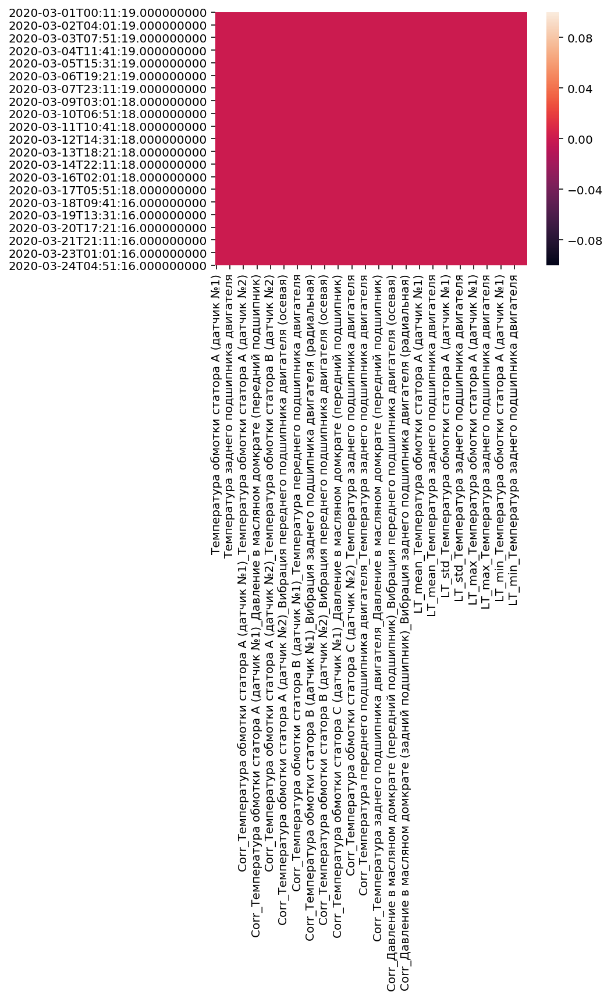

In [65]:
sns.heatmap(X.isna())

In [30]:
pd.set_option('display.max_columns', 500)
X.describe()

,Температура обмотки статора А (датчик №1),Температура обмотки статора А (датчик №2),Температура обмотки статора В (датчик №1),Температура обмотки статора В (датчик №2),Температура обмотки статора С (датчик №1),Температура обмотки статора С (датчик №2),Температура переднего подшипника двигателя,Температура заднего подшипника двигателя,Давление в масляном домкрате (передний подшипник),Давление в масляном домкрате (задний подшипник),Вибрация переднего подшипника двигателя (осевая),Вибрация переднего подшипника двигателя (радиальная),Вибрация заднего подшипника двигателя (осевая),Вибрация заднего подшипника двигателя (радиальная),Corr_Температура обмотки статора А (датчик №1)_Температура обмотки статора А (датчик №2),Corr_Температура обмотки статора А (датчик №1)_Температура обмотки статора В (датчик №1),Corr_Температура обмотки статора А (датчик №1)_Температура обмотки статора В (датчик №2),Corr_Температура обмотки статора А (датчик №1)_Температура обмотки статора С (датчик №1),Corr_Температура обмотки статора А (датчик №1)_Температура обмотки статора С (датчик №2),Corr_Температура обмотки статора А (датчик №1)_Температура переднего подшипника двигателя,Corr_Температура обмотки статора А (датчик №1)_Температура заднего подшипника двигателя,Corr_Температура обмотки статора А (датчик №1)_Давление в масляном домкрате (передний подшипник),Corr_Температура обмотки статора А (датчик №1)_Давление в масляном домкрате (задний подшипник),Corr_Температура обмотки статора А (датчик №1)_Вибрация переднего подшипника двигателя (осевая),Corr_Температура обмотки статора А (датчик №1)_Вибрация переднего подшипника двигателя (радиальная),Corr_Температура обмотки статора А (датчик №1)_Вибрация заднего подшипника двигателя (осевая),Corr_Температура обмотки статора А (датчик №1)_Вибрация заднего подшипника двигателя (радиальная),Corr_Температура обмотки статора А (датчик №2)_Температура обмотки статора В (датчик №1),Corr_Температура обмотки статора А (датчик №2)_Температура обмотки статора В (датчик №2),Corr_Температура обмотки статора А (датчик №2)_Температура обмотки статора С (датчик №1),Corr_Температура обмотки статора А (датчик №2)_Температура обмотки статора С (датчик №2),Corr_Температура обмотки статора А (датчик №2)_Температура переднего подшипника двигателя,Corr_Температура обмотки статора А (датчик №2)_Температура заднего подшипника двигателя,Corr_Температура обмотки статора А (датчик №2)_Давление в масляном домкрате (передний подшипник),Corr_Температура обмотки статора А (датчик №2)_Давление в масляном домкрате (задний подшипник),Corr_Температура обмотки статора А (датчик №2)_Вибрация переднего подшипника двигателя (осевая),Corr_Температура обмотки статора А (датчик №2)_Вибрация переднего подшипника двигателя (радиальная),Corr_Температура обмотки статора А (датчик №2)_Вибрация заднего подшипника двигателя (осевая),Corr_Температура обмотки статора А (датчик №2)_Вибрация заднего подшипника двигателя (радиальная),Corr_Температура обмотки статора В (датчик №1)_Температура обмотки статора В (датчик №2),Corr_Температура обмотки статора В (датчик №1)_Температура обмотки статора С (датчик №1),Corr_Температура обмотки статора В (датчик №1)_Температура обмотки статора С (датчик №2),Corr_Температура обмотки статора В (датчик №1)_Температура переднего подшипника двигателя,Corr_Температура обмотки статора В (датчик №1)_Температура заднего подшипника двигателя,Corr_Температура обмотки статора В (датчик №1)_Давление в масляном домкрате (передний подшипник),Corr_Температура обмотки статора В (датчик №1)_Давление в масляном домкрате (задний подшипник),Corr_Температура обмотки статора В (датчик №1)_Вибрация переднего подшипника двигателя (осевая),Corr_Температура обмотки статора В (датчик №1)_Вибрация переднего подшипника двигателя (радиальная),Corr_Температура обмотки статора В (датчик №1)_Вибрация заднего подшипника двигателя (осевая),Corr_Температура обмотки статора В (датчик №1)_Вибрация заднего подшипника двигателя (радиальная),Corr_Температура обмотк

In [24]:
from sklearn.impute import SimpleImputer, KNNImputer

imputer = KNNImputer()
X = pd.DataFrame(imputer.fit_transform(mmsX), columns=X.columns, index=X.index)

ValueError: Input contains infinity or a value too large for dtype('float64').

##  Стандартизация

In [50]:
from sklearn.preprocessing import StandardScaler

ss = StandardScaler()
X = pd.DataFrame(ss.fit_transform(X), columns=X.columns, index=X.index)

In [75]:
Val_X, Exam_X = X.loc[:"2020-03-18"], X.loc["2020-03-19":]
Val_y, Exam_y = y.loc[:"2020-03-18"], y.loc["2020-03-19":]

# Классификатор аномалий

In [2]:
from xgboost import XGBRegressor, XGBRFRegressor, XGBClassifier, XGBRFClassifier

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_validate, train_test_split, GridSearchCV
from sklearn.metrics import jaccard_similarity_score as IoU
from sklearn.metrics import classification_report, roc_auc_score, f1_score

In [ ]:
RandomForestClassifier()

In [ ]:
GridSearchCV()

## XGBoost Random Forest

### Подбор параметров на кросс-валидации

In [77]:
from tqdm.notebook import tqdm

Params = {
    "n_estimators": 10,
    "max_depth": 3,
    "booster": 'gbtree',
    "n_jobs": -1
}

N_EST_ARR = range(100, 160, 10)
MAX_DEPTH_ARR = range(2, 9)

param_comb = list(product(N_EST_ARR, MAX_DEPTH_ARR))
best_f1, best_roc_auc, best_jaccard = 0.0, 0.0, 0.0
RESULTS = []

for n_est, max_depth in tqdm(param_comb):

    Params['n_estimators'] = n_est
    Params['max_depth'] = max_depth

    CLF = XGBRFClassifier(**Params)
    CV_result = cross_validate(
        CLF,
        Val_X,
        Val_y,
        scoring=['f1', 'roc_auc', 'jaccard_weighted'],
        return_train_score=True,
        return_estimator=True)

    #======================================================================#
    # Сохранение результатов и метрик
    #======================================================================#
    res = dict()
    res['params'] = Params

    for part, metric in product(["train", "test"],
                                ["f1", "roc_auc", "jaccard_weighted"]):
        res[f"{part}_avg_{metric}"] = CV_result[f"{part}_{metric}"].mean()
        res[f"{part}_std_{metric}"] = CV_result[f"{part}_{metric}"].std()

    if res["test_avg_jaccard_weighted"] > best_jaccard:
        best_jaccard = res["test_avg_jaccard_weighted"]
        best_est = CV_result["estimator"]

    RESULTS.append(res)

    #======================================================================#

In [78]:
!telegram-send "IoU : {best_jaccard}"

In [79]:
RESULTS = pd.DataFrame(RESULTS)
RESULTS

,params,train_avg_f1,train_std_f1,train_avg_roc_auc,train_std_roc_auc,train_avg_jaccard_weighted,train_std_jaccard_weighted,test_avg_f1,test_std_f1,test_avg_roc_auc,test_std_roc_auc,test_avg_jaccard_weighted,test_std_jaccard_weighted
0,"{'n_estimators': 150, 'max_depth': 8, 'booster...",0.568652,0.126101,0.809056,0.013637,0.943476,0.010876,0.042007,0.057706,0.577973,0.144872,0.881903,0.033059
1,"{'n_estimators': 150, 'max_depth': 8, 'booster...",0.695640,0.040703,0.882074,0.039770,0.955905,0.004426,0.042821,0.059061,0.705905,0.181366,0.881192,0.032765
2,"{'n_estimators': 150, 'max_depth': 8, 'booster...",0.769458,0.061898,0.925036,0.023348,0.965033,0.008187,0.046333,0.054959,0.677940,0.175674,0.860251,0.063079
3,"{'n_estimators': 150, 'max_depth': 8, 'booster...",0.795433,0.061629,0.950524,0.010304,0.968344,0.008452,0.046197,0.054971,0.683232,0.176944,0.856754,0.063388
4,"{'n_estimators': 150, 'max_depth': 8, 'booster...",0.838589,0.060451,0.961908,0.010005,0.974143,0.008506,0.045263,0.054334,0.690081,0.170599,0.841293,0.066296
5,"{'n_estimators': 150, 'max_depth': 8, 'booster...",0.883070,0.044259,0.974635,0.007077,0.980429,0.006780,0.044787,0.053665,0.675824,0.178943,0.838520,0.067558
6,"{'n_estimators': 150, 'max_depth': 8, 'booster...",0.900470,0.034122,0.981366,0.008675,0.983005,0.005456,0.044006,0.052359,0.651613,0.181723,0.837208,0.068263
7,"{'n_estimators': 150, 'max_depth': 8, 'booster...",0.569100,0.126529,0.809362,0.013378,0.943548,0.010951,0.042172,0.057768,0.577499,0.145239,0.882276,0.032336
8,"{'n_estimators': 150, 'max_depth': 8, 'booster...",0.695640,0.040703,0.882356,0.039742,0.955905,0.004426,0.042821,0.059061,0.704811,0.180908,0.881008,0.032628
9,"{'n_estimators': 150, 'max_depth': 8, 'booster...",0.769255,0.063642,0.924702,0.023385,0.965034,0.008433,0.046475,0.054947,0.680614,0.176101,0.860257,0.061795


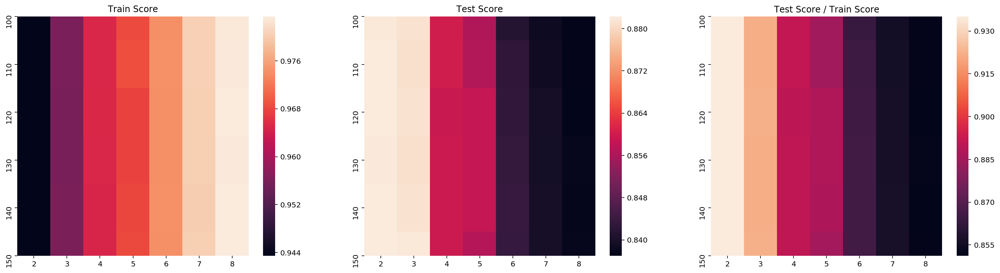

In [80]:
AVG_Train_Jaccard = RESULTS['train_avg_jaccard_weighted'].values.reshape(
    len(N_EST_ARR), len(MAX_DEPTH_ARR))
AVG_Test_Jaccard = RESULTS['test_avg_jaccard_weighted'].values.reshape(
    len(N_EST_ARR), len(MAX_DEPTH_ARR))

fig, axes = plt.subplots(1, 3, figsize=(24, 6))

axes[0].set_title("Train Score")
sns.heatmap(AVG_Train_Jaccard,
            xticklabels=MAX_DEPTH_ARR,
            yticklabels=N_EST_ARR,
            ax=axes[0])

axes[1].set_title("Test Score")
sns.heatmap(AVG_Test_Jaccard,
            xticklabels=MAX_DEPTH_ARR,
            yticklabels=N_EST_ARR,
            ax=axes[1])

axes[2].set_title("Test Score / Train Score")
sns.heatmap(AVG_Test_Jaccard / AVG_Train_Jaccard,
            xticklabels=MAX_DEPTH_ARR,
            yticklabels=N_EST_ARR,
            ax=axes[2])

In [81]:
for i, clf in enumerate(best_est):
    ValPreds = clf.predict(Val_X)
    ExamPreds = clf.predict(Exam_X)
    ValProbs = clf.predict_proba(Val_X)
    ExamProbs = clf.predict_proba(Exam_X)

    print(60 * "=")
    print(f"{i+1}-й Классификатор")
    print(60 * "=")

    print("Val Report:\n")
    print(classification_report(Val_y, ValPreds))
    print("Exam Report:\n")
    print(classification_report(Exam_y, ExamPreds))



1-й Классификатор
Val Report:

              precision    recall  f1-score   support

           0       0.97      0.98      0.98      4935
           1       0.52      0.45      0.48       247

    accuracy                           0.95      5182
   macro avg       0.74      0.71      0.73      5182
weighted avg       0.95      0.95      0.95      5182

Exam Report:

              precision    recall  f1-score   support

           0       0.94      0.90      0.92      1715
           1       0.09      0.15      0.11       111

    accuracy                           0.85      1826
   macro avg       0.52      0.53      0.52      1826
weighted avg       0.89      0.85      0.87      1826

2-й Классификатор
Val Report:

              precision    recall  f1-score   support

           0       0.97      1.00      0.98      4935
           1       0.90      0.28      0.43       247

    accuracy                           0.96      5182
   macro avg       0.93      0.64      0.70      518

<ErrorbarContainer object of 3 artists>

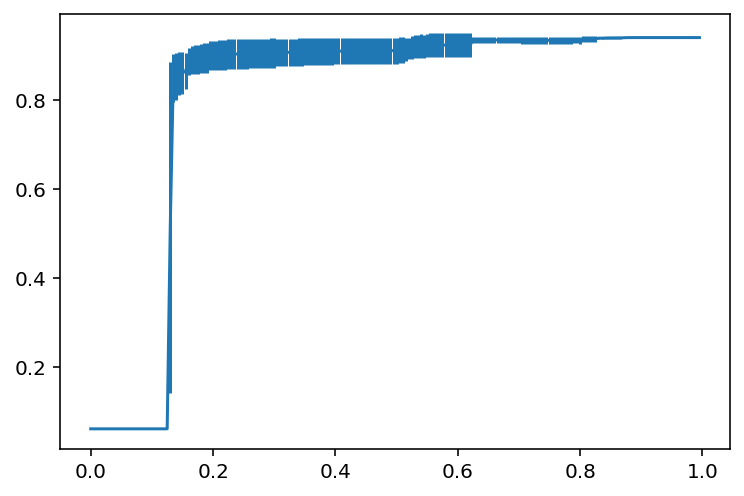

In [82]:
def predict(clf, thrs, X):
    return (clf.predict_proba(X)[:,1] > thrs).astype(int)

Metrics = []
for thrs in tqdm(np.arange(0.0, 1.0, 0.005)):
    clf_metrics = []
    for clf in best_est:
        preds = predict(clf, thrs, Exam_X)
        clf_metrics.append(IoU(Exam_y, preds))
    Metrics.append(clf_metrics)
    
Metrics = np.array(Metrics)

plt.errorbar(np.arange(0.0, 1.0, 0.005), Metrics.mean(axis=1), Metrics.std(axis=1))

### Визуализация важности признаков

In [83]:
FeatureImportances = sorted(zip(X.columns, clf.feature_importances_), 
                            key = lambda x: x[1], reverse=True)

TDA_FI = [fi for fi in FeatureImportances if fi[0].startswith('LT_')]
CorrFI = [fi for fi in FeatureImportances if fi[0].startswith('Corr_')]
InitFI = sorted(set(FeatureImportances) - set(CorrFI) - set(TDA_FI), key=lambda x: x[1], reverse=True)

#### Общий ТОП признаков

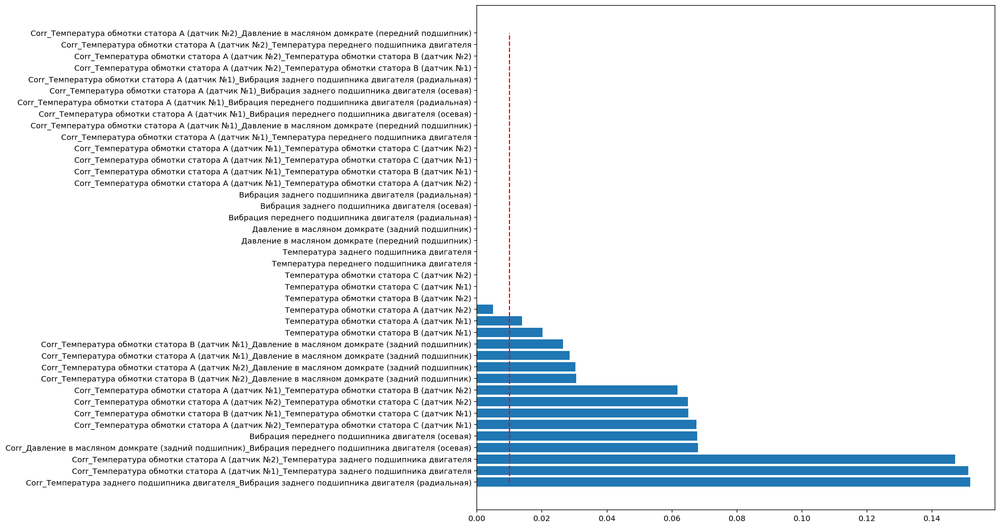

In [85]:
TOP_N = 20

plt.figure(figsize=(12, 12))
plt.vlines(0.01, 1, 2 * TOP_N, colors='red', linestyle='dashed')
plt.barh(range(1, 2 * TOP_N + 1),
         [fi[1] for fi in FeatureImportances[:2 * TOP_N]],
         tick_label=[fi[0] for fi in FeatureImportances[:2 * TOP_N]])
plt.show()

### Визуализация предсказаний

In [86]:
ValProbs.shape

(5182, 2)

In [87]:
ExamProbs.shape

(1826, 2)

In [88]:
from sklearn.preprocessing import MinMaxScaler
mms = MinMaxScaler()

ScaledData = pd.DataFrame(mms.fit_transform(X), columns=X.columns, index=X.index)
ScaledValData = pd.DataFrame(mms.fit_transform(Val_X), columns=Val_X.columns, index=Val_X.index)
ScaledExamData = pd.DataFrame(mms.fit_transform(Exam_X), columns=Exam_X.columns, index=Exam_X.index)

Probs = pd.Series(np.concatenate([ValProbs[:,1], ExamProbs[:,1]]), index=X.index)

In [89]:
import plotly.graph_objects as go
import plotly.express as px

config = dict({'scrollZoom': True})

import pandas as pd
sens_name_1 = ScaledData.columns[12]
sens_name_2 = ScaledData.columns[13]

Sens_1 = ScaledData[sens_name_1].values
Sens_2 = ScaledData[sens_name_2].values

fig = go.Figure()
fig.add_trace(go.Scatter(x=ScaledData.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))
fig.add_trace(go.Scatter(x=ScaledData.index, y=Sens_2, name="Вибрация ЗПД (рад.)"))
fig.add_traces([
    go.Scatter(x=ScaledData.index,
               y=Data.target.values, 
               fill="tozerox",
               name="Остановки"),
    go.Scatter(x=ScaledData.index,
               y=Probs,
               fill="tozeroy",
               name="Уровень опасности"),
])

#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("Febraury_XGBoost_Results.html", config=config)